# Análise dos áudios originais (amostras do dataset) - Espectrogramas, ondas e Sample Rate

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py
import IPython
import IPython.display as ipd  # To play sound in the notebook
import plotly.graph_objs as go
import plotly.offline as offline
import plotly.tools as tls
import wave
import librosa
import librosa.display
import os
import glob
import pandas
import pyloudnorm as pyln
import soundfile as sf
from random import shuffle
from tqdm import tqdm_notebook
from pydub import AudioSegment
from scipy.fftpack import fft
from scipy import signal

In [2]:
%matplotlib inline 
color = sns.color_palette()
#py.init_notebook_mode(connected=True)
offline.init_notebook_mode()

## Tópicos

1. __Espectrogramas__: Espectrogramas de todos os áudios (amostras da base original)
2. __Plot da onda__: Plots de todos os waveforms (amostras da base original)
3. __Gráfico das SRs__: Gráfico em pilhas das sample rates originais dos áudios

## Carregar áudios

In [3]:
def load_wav_file(path):
    b, sr = sf.read(path) 
    return sr, b

In [4]:
data = pandas.DataFrame(columns=['path', 'name', 'sr', 'time_series', 'label', 'class'])
data['path'] = glob.glob('../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/**/*.wav', recursive=True)
data['name'] = data['path'].apply(lambda p: os.path.splitext(os.path.basename(p))[0])
wavs = [load_wav_file(p) for p in data['path']]
data['time_series'] = [wav[1] for wav in wavs]
data['sr'] = [wav[0] for wav in wavs]
data['nframes'] = data['time_series'].apply(len)

## Carregar CSV

In [5]:
csv = open('../Respiratory_Sound_Database/Respiratory_Sound_Database/patient_diagnosis.csv').readlines()
data_labels = dict()
for line in csv:
    data_labels[line.split(',')[0]] = line.split(',')[1].rstrip()
data['label'] = data['name'].apply(lambda n: data_labels[n.split('_')[0]])

In [6]:
data.head()

,path,name,sr,time_series,label,class,nframes
0,../Respiratory_Sound_Database/Respiratory_Soun...,107_2b5_Ll_mc_AKGC417L,44100,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",COPD,NaN,882000
1,../Respiratory_Sound_Database/Respiratory_Soun...,200_2p3_Ar_mc_AKGC417L,44100,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",COPD,NaN,882000
2,../Respiratory_Sound_Database/Respiratory_Soun...,174_2p3_Pl_mc_AKGC417L,44100,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",COPD,NaN,882000
3,../Respiratory_Sound_Database/Respiratory_Soun...,130_2b3_Ar_mc_AKGC417L,44100,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",COPD,NaN,882000
4,../Respiratory_Sound_Database/Respiratory_Soun...,130_3p3_Tc_mc_AKGC417L,44100,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",COPD,NaN,882000


In [8]:
data_labels_df = pd.DataFrame.from_dict(data_labels, orient='index', columns=['label'])

In [9]:
data_labels_df.head()

,label
101,URTI
102,Healthy
103,Asthma
104,COPD
105,URTI


## Gráficos

### CSV

É importante notar a quantidade de instâncias deste dataset. 

Tomando como exemplo apenas as classes 'Healthy' e 'Pneumonia', a princípio, existe uma quantidade balanceada de áudios dessas classes. Entretanto, ao observar a quantidade de instâncias por paciente (id), vemos que há uma quantidade significativamente menor de instâncias da classe 'Pneumonia'.

_Compare o gráfico a seguir com o gráfico dos áudios_

Número total de labels no dataset :  8
Labels :  ['URTI' 'Healthy' 'Asthma' 'COPD' 'LRTI' 'Bronchiectasis' 'Pneumonia'
 'Bronchiolitis']


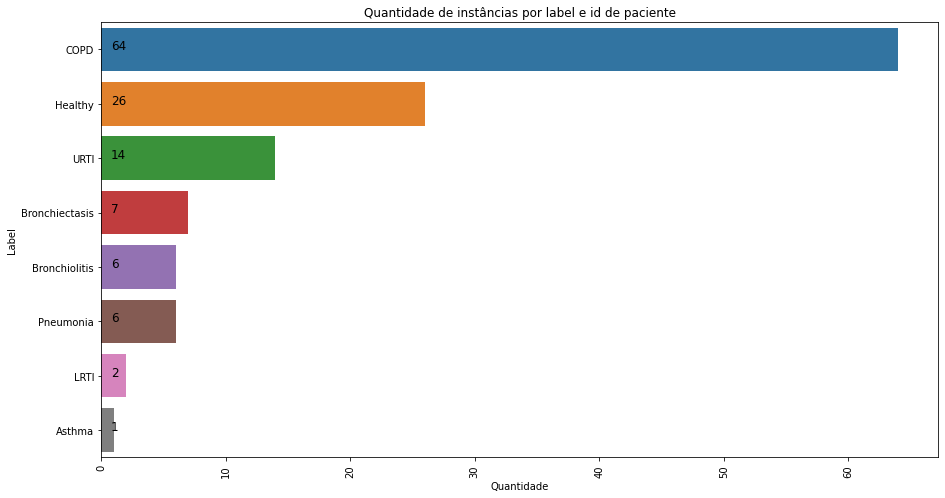

In [20]:
print("Número total de labels no dataset : ", len(data_labels_df['label'].value_counts()))
print("Labels : ", data_labels_df['label'].unique())
plt.figure(figsize=(15,8))
counts = data_labels_df['label'].value_counts()
sns.barplot(counts.values, counts.index)
for i, v in enumerate(counts.values):
    plt.text(0.8,i,v,color='k',fontsize=12)
plt.xticks(rotation='vertical')
plt.xlabel('Quantidade')
plt.ylabel('Label')
plt.title("Quantidade de instâncias por label e id de paciente")
plt.show()

### Áudios

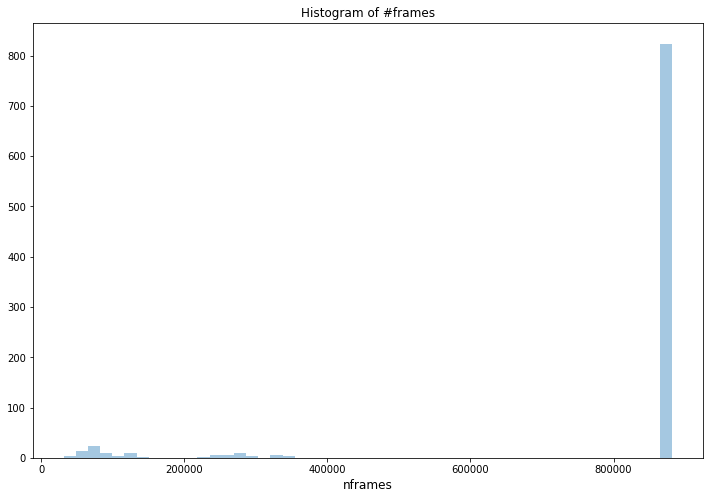

In [21]:
plt.figure(figsize=(12,8))
sns.distplot(data.nframes.values, bins=50, kde=False)
plt.xlabel('nframes', fontsize=12)
plt.title("Histogram of #frames")
plt.show()

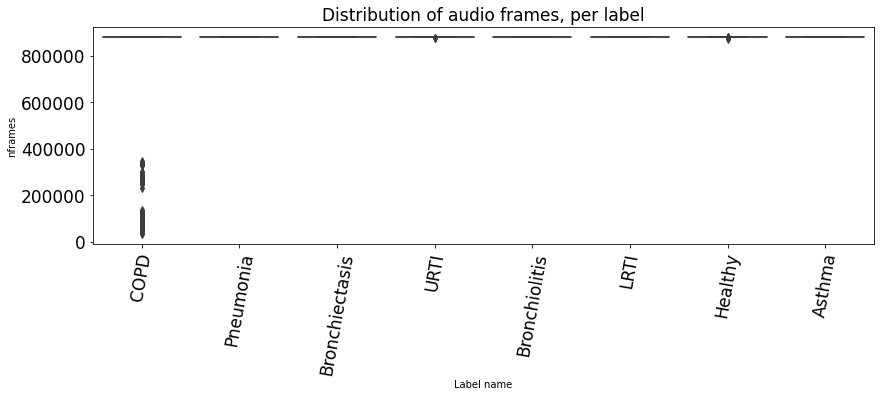

In [22]:
plt.figure(figsize=(14,4))
boxplot = sns.boxplot(x="label", y="nframes", data=data)
boxplot.set(xlabel='', ylabel='')
plt.title('Distribution of audio frames, per label', fontsize=17)
plt.xticks(rotation=80, fontsize=17)
plt.yticks(fontsize=17)
plt.xlabel('Label name')
plt.ylabel('nframes')
plt.show()

Número total de labels no dataset :  8
Labels :  ['COPD' 'Pneumonia' 'Bronchiectasis' 'URTI' 'Bronchiolitis' 'LRTI'
 'Healthy' 'Asthma']


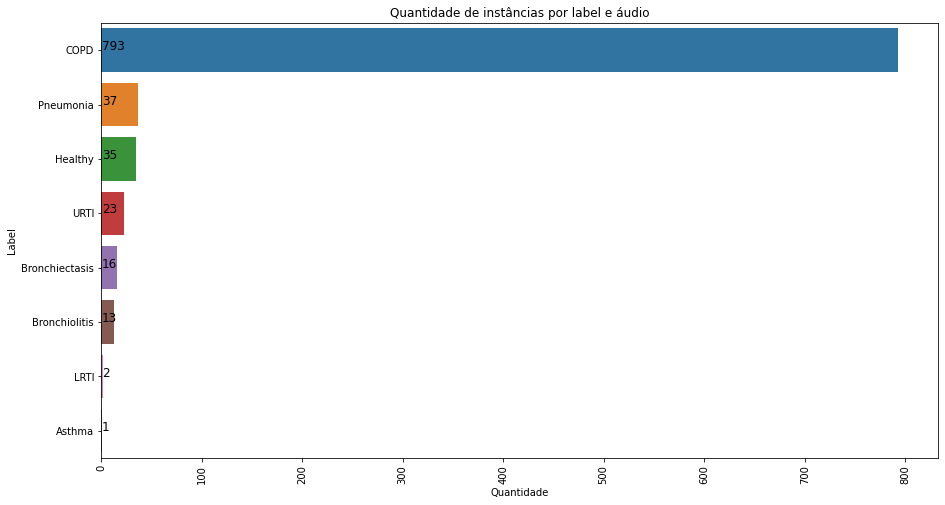

In [23]:
print("Número total de labels no dataset : ", len(data['label'].value_counts()))
print("Labels : ", data['label'].unique())
plt.figure(figsize=(15,8))
counts = data['label'].value_counts()
sns.barplot(counts.values, counts.index)
for i, v in enumerate(counts.values):
    plt.text(0.8,i,v,color='k',fontsize=12)
plt.xticks(rotation='vertical')
plt.xlabel('Quantidade')
plt.ylabel('Label')
plt.title("Quantidade de instâncias por label e áudio")
plt.show()

In [24]:
temp = data['sr'].value_counts()
labels = temp.index
sizes = (temp / temp.sum())*100
trace = go.Pie(labels=labels, values=sizes, hoverinfo='label+percent')
layout = go.Layout(title='Instances by Frames')
fig = go.Figure(data=[trace], layout=layout)
py.iplot(fig)

count
label          sr          
Asthma         44100      1
Bronchiectasis 44100     16
Bronchiolitis  44100     13
COPD           4000      90
               10000      6

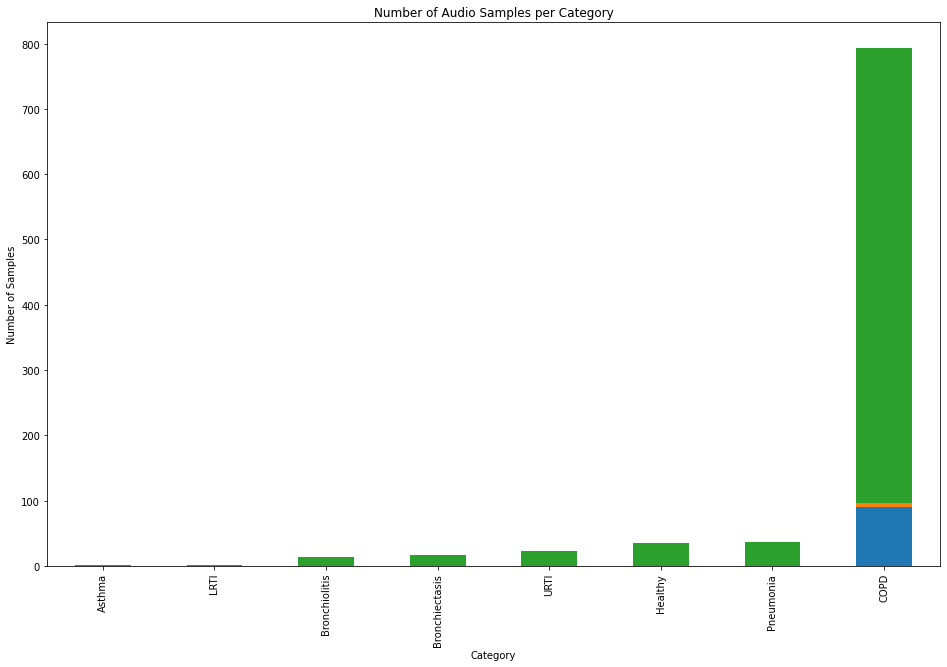

In [25]:
temp = pandas.DataFrame(zip(data['path'], data['label'], data['sr']), 
                        columns=['count', 'label', 'sr'])

category_group = temp.groupby(['label', 'sr']).count()
plot = category_group.unstack().reindex(category_group.unstack().sum(axis=1).sort_values().index)\
          .plot(kind='bar', stacked=True, title="Number of Audio Samples per Category", figsize=(16,10))
plot.set_xlabel("Category")
plot.set_ylabel("Number of Samples");
plot.get_legend().remove()
category_group.head()

---

In [26]:
def log_specgram(audio, sample_rate, window_size=20,
                 step_size=10, eps=1e-10):
    nperseg = int(round(window_size * sample_rate / 1e3))
    noverlap = int(round(step_size * sample_rate / 1e3))
    freqs, times, spec = signal.spectrogram(audio,
                                            fs=sample_rate,
                                            window='hann',
                                            nperseg=nperseg,
                                            noverlap=noverlap,
                                            detrend=False)
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

In [27]:
def mfcc_specgram(audio, sample_rate, nframes, n_mfcc=13):
    mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=n_mfcc)
    pad_width = max_pad_len - mfccs.shape[1]
    mfccs = np.pad(mfccs, pad_width=((0, 0), (0, pad_width)), mode='constant')
    return mfccs

In [28]:
os.makedirs('analysis/wave', exist_ok=True)
os.makedirs('analysis/spec', exist_ok=True)
os.makedirs('analysis/mfcc', exist_ok=True)

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/219_2b2_Tc_mc_LittC2SE.wav


loudness= -36.56655493145249


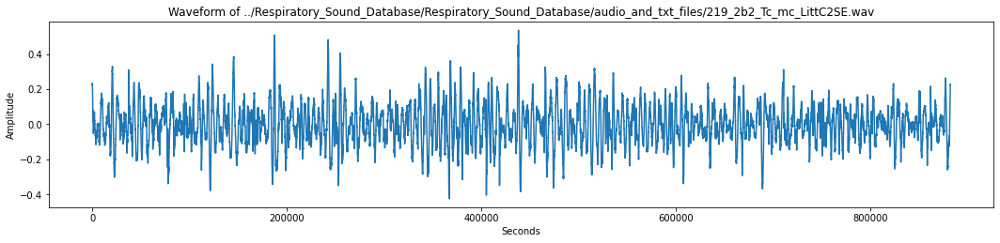

(1999, 442) (442,) (1999,)


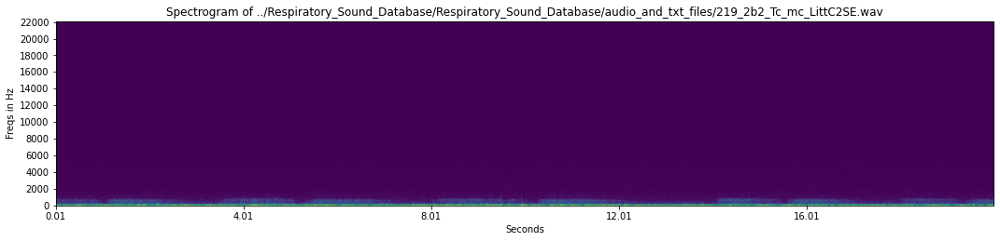

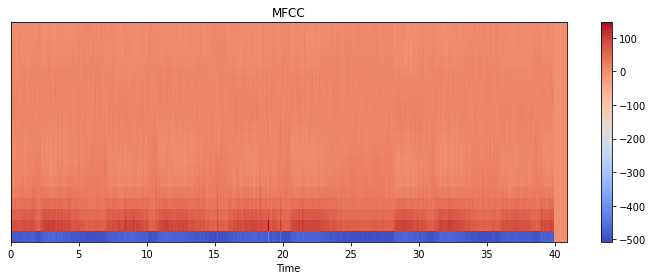

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/146_2b2_Pl_mc_AKGC417L.wav


loudness= -47.29999615639533


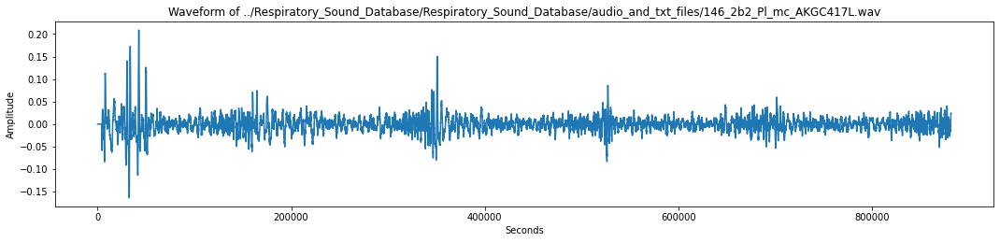

(1999, 442) (442,) (1999,)


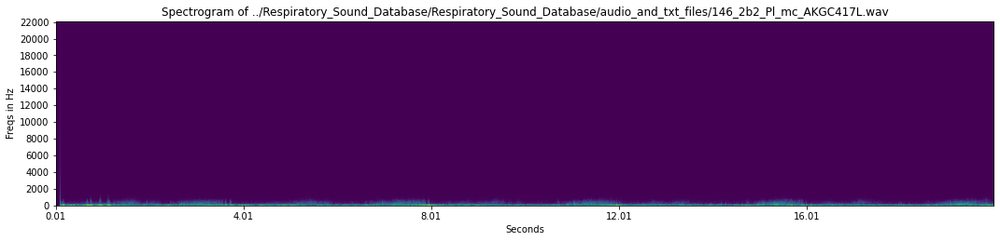

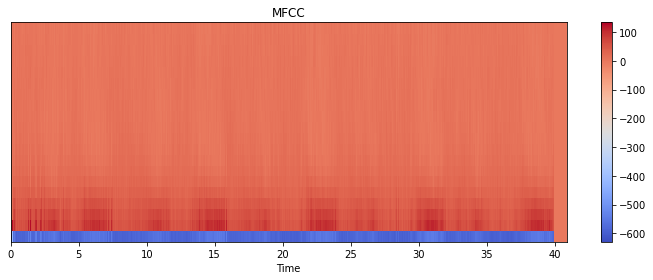

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/205_3b4_Pl_mc_AKGC417L.wav


loudness= -28.961052029045803


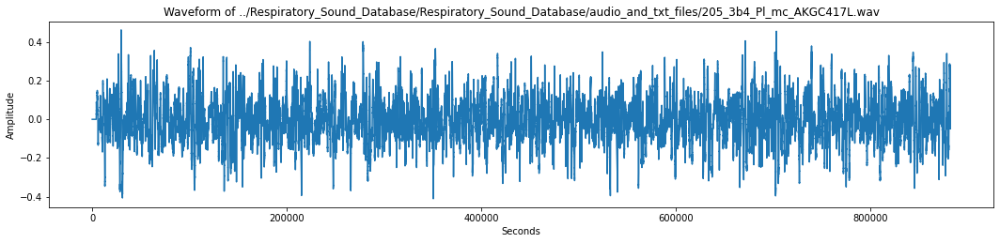

(1999, 442) (442,) (1999,)


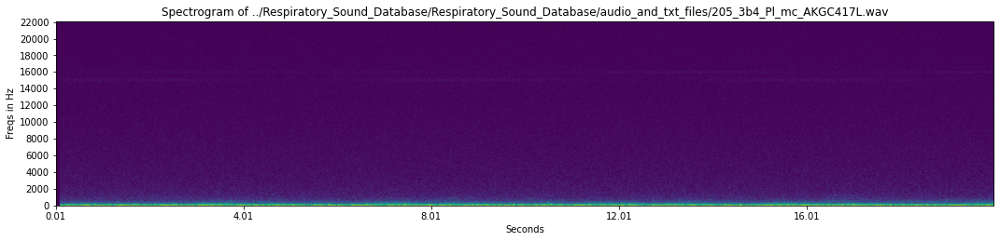

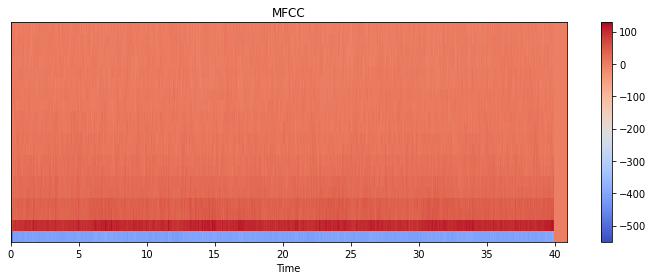

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/109_1b1_Pr_sc_Litt3200.wav


loudness= -29.10090379822184


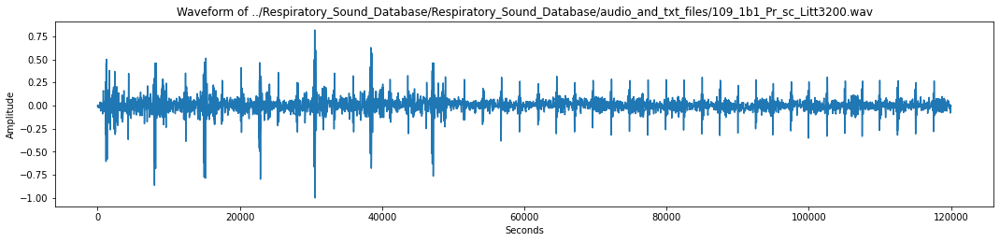

(2999, 41) (41,) (2999,)


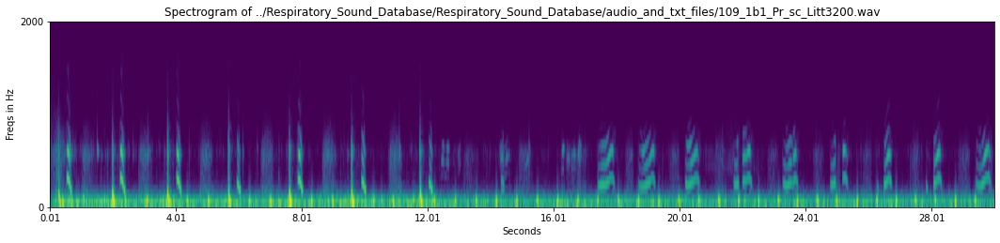

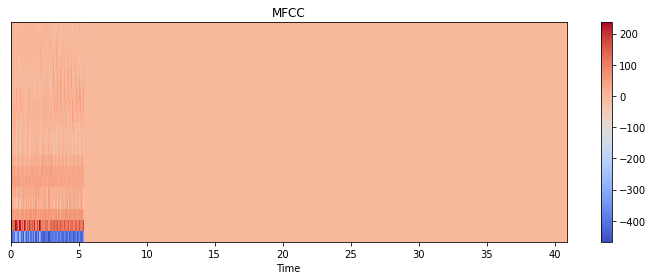

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/176_1b3_Al_mc_AKGC417L.wav


loudness= -28.89602514711245


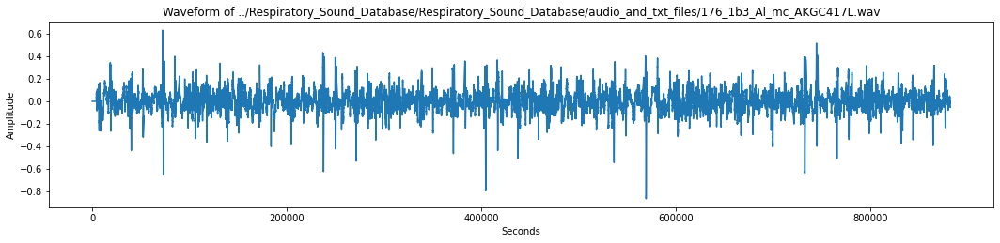

(1999, 442) (442,) (1999,)


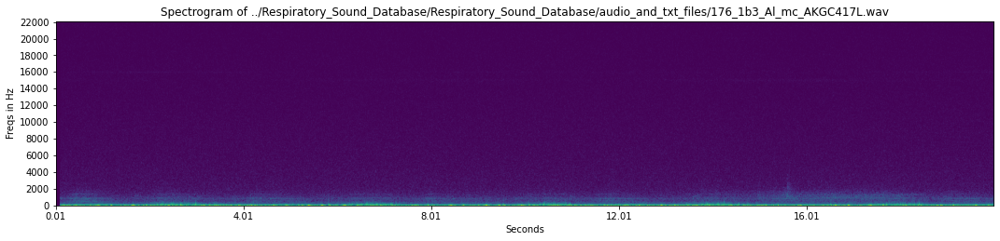

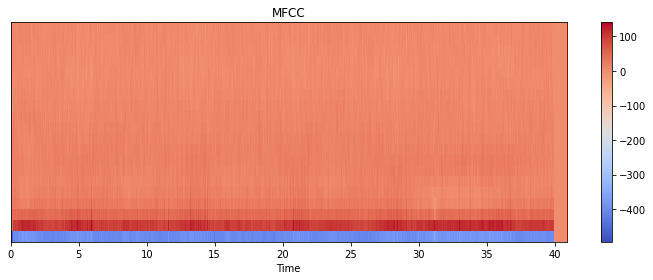

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/200_2p2_Tc_mc_AKGC417L.wav


loudness= -20.095061621932487


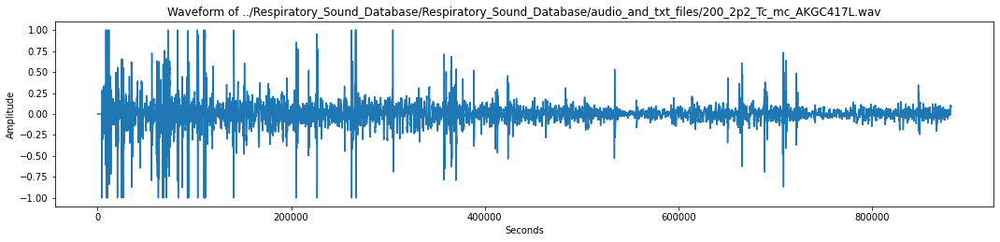

(1999, 442) (442,) (1999,)


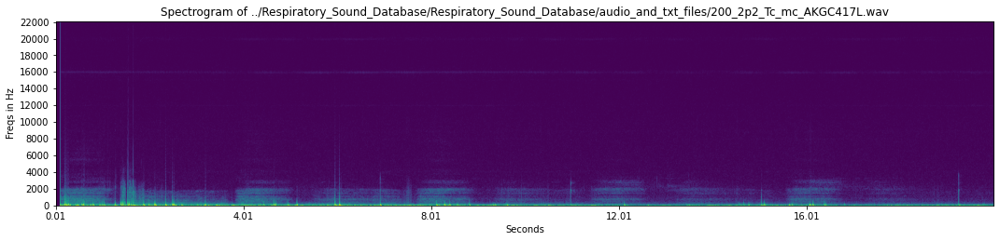

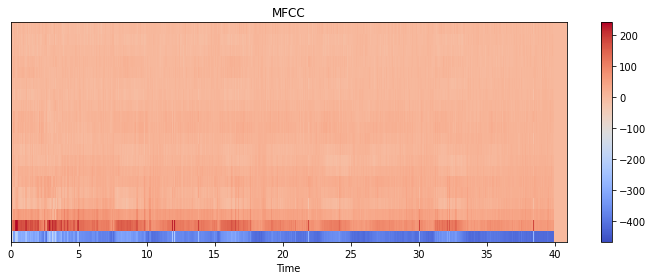

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/193_1b2_Ll_mc_AKGC417L.wav


loudness= -32.40890374576497


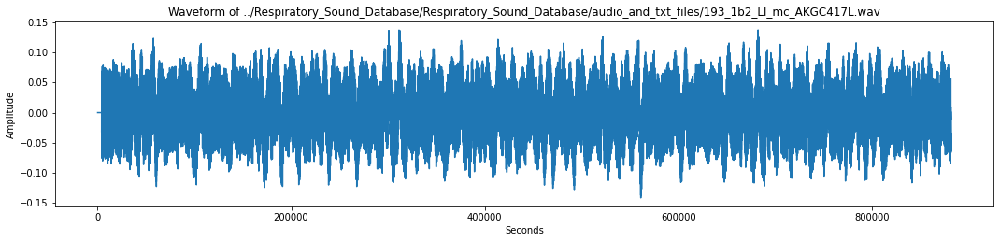

(1999, 442) (442,) (1999,)


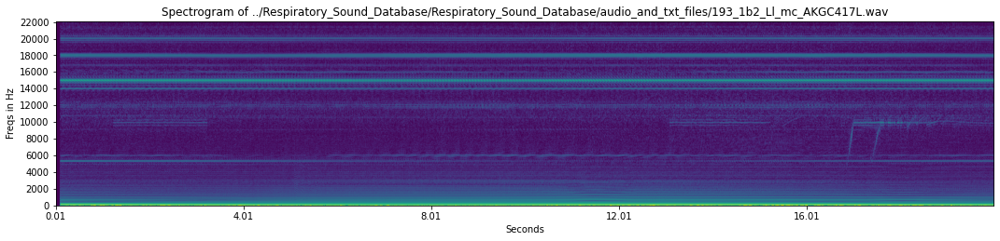

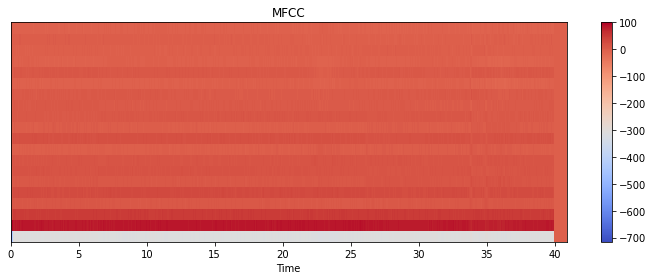

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/162_2b4_Pr_mc_AKGC417L.wav


loudness= -20.008231874803275


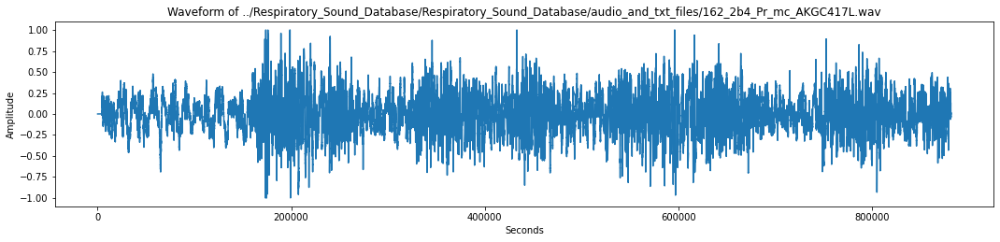

(1999, 442) (442,) (1999,)


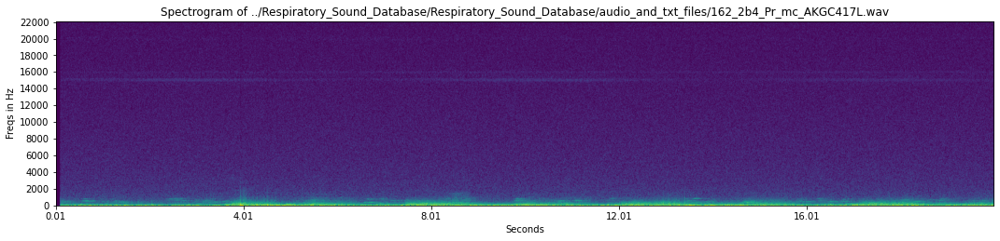

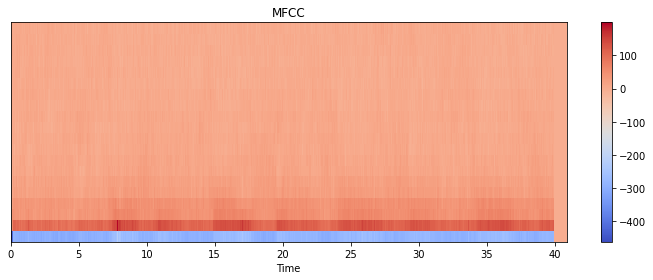

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/204_7p5_Al_mc_AKGC417L.wav


loudness= -30.291871602816446


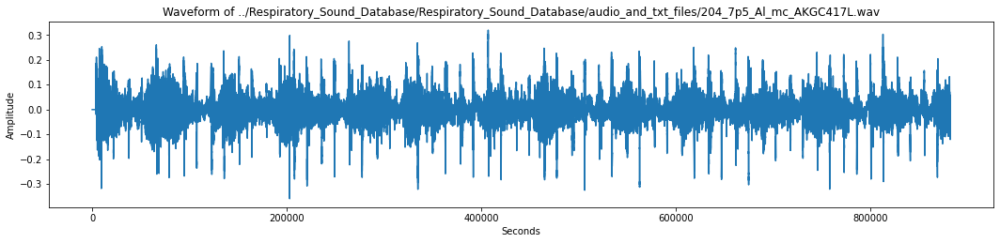

(1999, 442) (442,) (1999,)


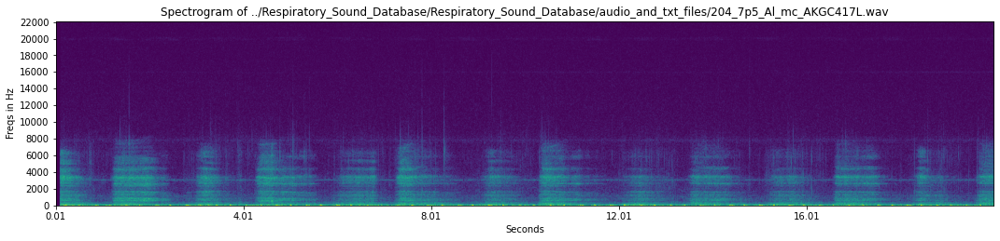

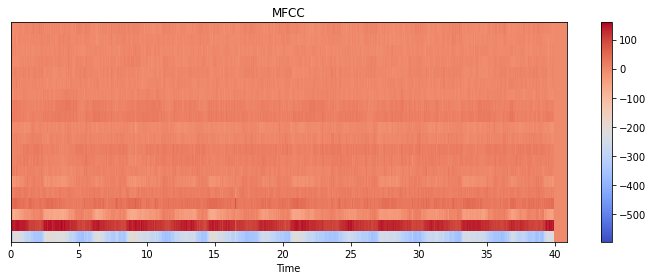

Playing ../Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/107_2b5_Pl_mc_AKGC417L.wav


loudness= -17.03168585690849


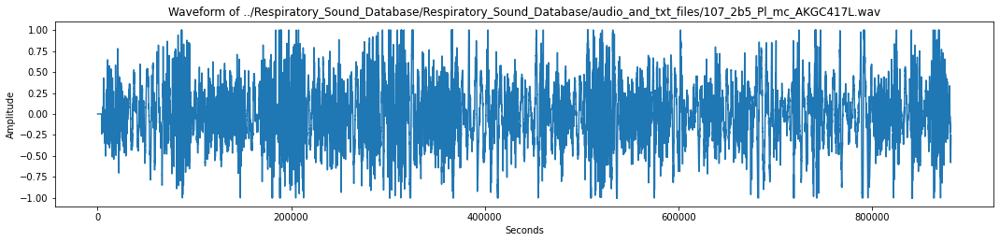

(1999, 442) (442,) (1999,)


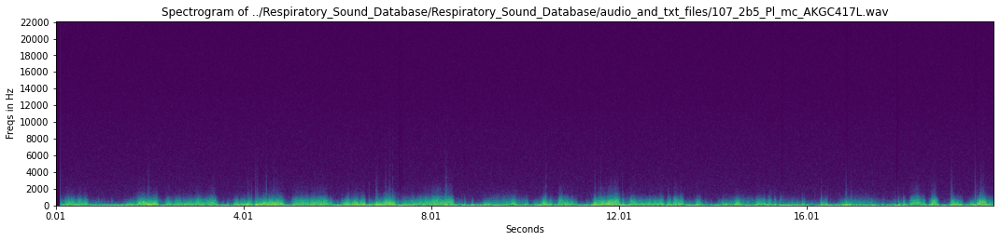

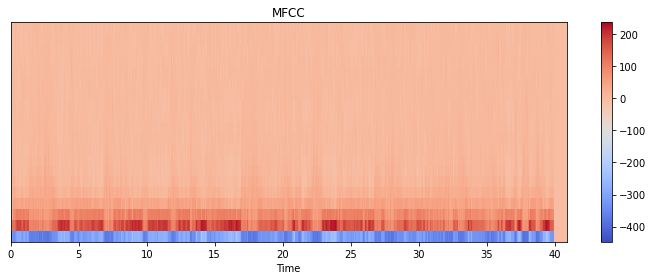

In [19]:
max_pad_len = 1760
samples = data.sample(n=10, random_state=1)
for fname, audio_path, label, nframes, b, sr in \
        zip(samples['name'], samples['path'], samples['label'], 
            samples['nframes'], samples['time_series'], samples['sr']):
    print('Playing', audio_path)
    output_name = fname
#     b, sr = sf.read(audio_path)
    IPython.display.display(ipd.Audio(audio_path))
    
    meter = pyln.Meter(sr) # create BS.1770 meter
    loudness = meter.integrated_loudness(b) # measure loudness
    print('loudness=', loudness)
    
    fig = plt.figure(figsize=(18, 8))
    ax2 = fig.add_subplot(211)
    ax2.plot(b)
    ax2.set_title('Waveform of ' + audio_path)
    ax2.set_ylabel('Amplitude')
    ax2.set_xlabel('Seconds')
    fig.savefig(os.path.join("analysis", "wave", output_name + ".png"), dpi=100) 
    plt.show()
    plt.close()
    
    freqs, times, spectrogram = log_specgram(b, sr)
    print(spectrogram.shape, freqs.shape, times.shape)
    fig = plt.figure(figsize=(18, 8))
    ax2 = fig.add_subplot(211)
    ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
               extent=[times.min(), times.max(), freqs.min(), freqs.max()])
    ax2.set_yticks(freqs[::40])
    ax2.set_xticks(times[::400])
    ax2.set_title('Spectrogram of ' + audio_path)
    ax2.set_ylabel('Freqs in Hz')
    ax2.set_xlabel('Seconds')
    fig.savefig(os.path.join("analysis", "spec", output_name + ".png"), dpi=100) 
    plt.show()
    plt.close()
    
    spectrogram = mfcc_specgram(b, sr, nframes, n_mfcc=20)
    fig = plt.figure(figsize=(10, 4))
    librosa.display.specshow(spectrogram, x_axis='time')
    plt.colorbar()
    plt.title('MFCC')
    plt.tight_layout()
    fig.savefig(os.path.join("analysis", "mfcc", output_name + ".png"), dpi=100) 
    plt.show()
    plt.close()
    